# CONVERSION RATE

## LIBRAIRIES & FUNCTION

In [1]:
# 1. Imports et chargement des données
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import joblib
from joblib import load
import re




from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, VotingClassifier
from sklearn.ensemble import StackingClassifier
from xgboost import XGBClassifier
from imblearn.over_sampling import SMOTE
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix, ConfusionMatrixDisplay


# Suppress warnings
import warnings
warnings.filterwarnings("ignore")

fonction entrainement et sauvegarde du model

In [2]:

def save_trained_model(name, model, X_train, Y_train):
    """
    Entraîne et sauvegarde un modèle sklearn/XGBoost avec joblib.
    
    Args:
        name (str): nom du fichier de sauvegarde (ex. "xgboost")
        model: instance du modèle (déjà configurée avec les meilleurs hyperparamètres)
        X_train: features d'entraînement
        Y_train: labels d'entraînement
    """
    model.fit(X_train, Y_train)
    joblib.dump(model, f"best_model_{name}.joblib")
    print(f"✅ Modèle '{name}' sauvegardé dans : best_model_{name}.joblib")


fonction graphique resulatats

In [3]:
def graph_perf(Y_train, Y_train_pred, Y_test, Y_test_pred, title="modele"):
    """
    Affiche les matrices de confusion + scores, et retourne un DataFrame avec noms de lignes formatés.
    """

    def compute_scores(y_true, y_pred):
        return {
            "Precision": round(precision_score(y_true, y_pred), 4),
            "Recall": round(recall_score(y_true, y_pred), 4),
            "F1-score": round(f1_score(y_true, y_pred), 4)
        }

    scores_train = compute_scores(Y_train, Y_train_pred)
    scores_test = compute_scores(Y_test, Y_test_pred)

    # Nouveau DataFrame avec colonne "model"
    df_scores = pd.DataFrame([
        {"model": f"{title}_train", **scores_train},
        {"model": f"{title}_test", **scores_test}
    ])

    # Affichage
    fig, axes = plt.subplots(1, 3, figsize=(14, 5))
    fig.suptitle(title, fontsize=16)

    def plot_confusion(ax, y_true, y_pred, label):
        cm = confusion_matrix(y_true, y_pred)
        cm_norm = cm.astype('float') / cm.sum(axis=1, keepdims=True)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
        disp.plot(ax=ax, cmap='Blues', values_format='d', colorbar=False)
        for i in range(cm.shape[0]):
            for j in range(cm.shape[1]):
                ax.text(j, i - 0.1, f"({cm_norm[i, j]*100:.1f}%)", ha='center', va='bottom', fontsize=9)
        ax.set_title(label, fontsize=12)
        ax.tick_params(axis='both', labelsize=10)

    plot_confusion(axes[0], Y_train, Y_train_pred, "Matrice de Confusion (Train)")
    plot_confusion(axes[2], Y_test, Y_test_pred, "Matrice de Confusion (Test)")

    # Tableau des scores au centre
    df_display = df_scores.set_index("model")
    axes[1].axis('off')
    table = axes[1].table(cellText=df_display.values,
                          colLabels=df_display.columns,
                          rowLabels=df_display.index,
                          cellLoc='center',
                          loc='center')
    table.auto_set_font_size(False)
    table.set_fontsize(10)
    table.scale(1.4, 1.6)
    axes[1].set_title("Scores de performance", fontsize=12)

    plt.tight_layout(rect=[0, 0, 1, 0.93])
    plt.show()

    return df_scores





In [4]:
# Dictionnaire pour enregistrer les noms des modèles
models_dict = {}

def ajouter_modele(nom: str):
    """
    Ajoute une entrée dans models_dict avec comme clé 'nom'
    et comme valeur le nom du modèle dans l'environnement, sous forme de string '<nom>_model'.
    """
    models_dict[nom] = f"{nom}_model"
    print(f"✅ Modèle '{nom}_model' ajouté au dictionnaire sous la clé '{nom}'.")


## DATASET

In [5]:
dataset = pd.read_csv("conversion_data_train.csv")

print("Number of rows : {}".format(dataset.shape[0]))
print()

print("Display of dataset: ")
display(dataset.head())
print()

print("Basics statistics: ")
data_desc = dataset.describe(include='all')
display(data_desc)
print()

print("Percentage of missing values: ")
display(100*dataset.isnull().sum()/dataset.shape[0])


Number of rows : 284580

Display of dataset: 


,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0



Basics statistics: 


,country,age,new_user,source,total_pages_visited,converted
count,284580,284580.000000,284580.000000,284580,284580.000000,284580.000000
unique,4,NaN,NaN,3,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN
freq,160124,NaN,NaN,139477,NaN,NaN
mean,NaN,30.564203,0.685452,NaN,4.873252,0.032258
std,NaN,8.266789,0.464336,NaN,3.341995,0.176685
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000
75%,NaN,36.000000,1.000000,NaN,7.000000,0.000000



Percentage of missing values: 


country                0.0
age                    0.0
new_user               0.0
source                 0.0
total_pages_visited    0.0
converted              0.0
dtype: float64

## EDA

In [6]:
features = ['converted', 'country', 'age', 'new_user', 'source', 'total_pages_visited']
for i in range(len(features)):
    fig = px.histogram(dataset[features[i]])
    fig.show()

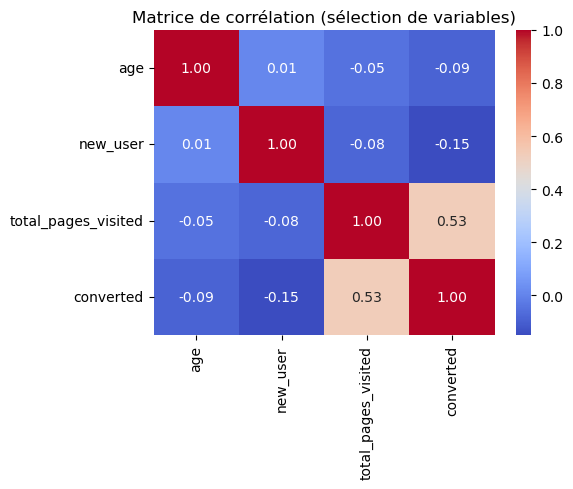

In [7]:
# Matrice de corrélation simple sans plotly
corr_features = ['age', 'new_user', 'total_pages_visited', 'converted']
corr_matrix = dataset.loc[:, corr_features].corr().round(2)

plt.figure(figsize=(6, 5))
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Matrice de corrélation (sélection de variables)")
plt.tight_layout()
plt.show()


## PRE-PROCESSING

### outliers

In [8]:
# Drop lines containing outliers using IQR method
cols = ['age']

print('Dropping outliers in Quantitaive data...')

for col in cols:
    Q1 = dataset[col].quantile(0.25)
    Q3 = dataset[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    to_keep = (dataset[col] >= lower_bound) & (dataset[col] <= upper_bound)
    dataset = dataset[to_keep]

print('✅ Done. Number of lines remaining :', dataset.shape[0])


Dropping outliers in Quantitaive data...
✅ Done. Number of lines remaining : 283211


### target 

In [9]:
# Separate target variable Y from features X
target_name = 'converted'

print("Separating labels from features...")
Y = dataset.loc[:,target_name]
X = dataset.drop(target_name, axis = 1) # All columns are kept, except the target

print(Y.head())

print(X.head())


Separating labels from features...
0    0
1    0
2    1
3    0
4    0
Name: converted, dtype: int64
   country  age  new_user  source  total_pages_visited
0    China   22         1  Direct                    2
1       UK   21         1     Ads                    3
2  Germany   20         0     Seo                   14
3       US   23         1     Seo                    3
4       US   28         1  Direct                    3


### Train/test split 

In [10]:
# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0, stratify=Y)


print(f"\nTaille du jeu d'entraînement : {X_train.shape[0]} lignes")
print(f"\nTaille du jeu de test : {X_test.shape[0]} lignes")

Dividing into train and test sets...

Taille du jeu d'entraînement : 226568 lignes

Taille du jeu de test : 56643 lignes


### Pipeline

In [11]:
# Create pipeline for numeric features
numeric_features = ["age","total_pages_visited"]
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

# Create pipeline for categorical features
categorical_features = ['country', 'new_user', 'source'] 
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first'))
    ])

In [12]:
# Use ColumnTranformer to make a preprocessor object that describes all the treatments to be done
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Preprocessings on train set
print("Performing preprocessings on train set...")
print(X_train.head())
X_train = preprocessor.fit_transform(X_train)
print('...Done.')
print(X_train[0:5,:])


# Preprocessings on test set
print("Performing preprocessings on test set...")
print(X_test.head())
X_test = preprocessor.transform(X_test)
print('...Done.')
print(X_test[0:5,:])


Performing preprocessings on train set...
       country  age  new_user  source  total_pages_visited
180875   China   25         1     Seo                    8
129776      US   44         1  Direct                    3
86678       US   29         0     Seo                    4
86884       US   30         1     Seo                    3
76461       US   38         1  Direct                    3
...Done.
[[-0.67261049  0.93633055  0.          0.          0.          1.
   0.          1.        ]
 [ 1.68300013 -0.56034821  0.          0.          1.          1.
   1.          0.        ]
 [-0.17669247 -0.26101246  0.          0.          1.          0.
   0.          1.        ]
 [-0.05271296 -0.56034821  0.          0.          1.          1.
   0.          1.        ]
 [ 0.93912309 -0.56034821  0.          0.          1.          1.
   1.          0.        ]]
Performing preprocessings on test set...
        country  age  new_user  source  total_pages_visited
236036       US   51        

### sauvegarde de l'encodage 

In [13]:
# Sauvegarde du préprocesseur entraîné
joblib.dump(preprocessor, "preprocessor.joblib")

['preprocessor.joblib']

## ENTRAINEMENT MODELES

### Regression logistic

In [14]:
# Train model
print("Train model...")
model_reg_log = LogisticRegression(max_iter=1000, C=1)
save_trained_model("regression_logistique", model_reg_log, X_train, Y_train)
print("...Done.")

Train model...
✅ Modèle 'regression_logistique' sauvegardé dans : best_model_regression_logistique.joblib
...Done.


In [15]:
# Predictions on training set
print("Predictions on training set...")
Y_train_pred = model_reg_log.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = model_reg_log.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# Print F1 scores
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]

Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]

f1-score on train set :  0.7645370789910889
f1-score on test set :  0.7612165010538994


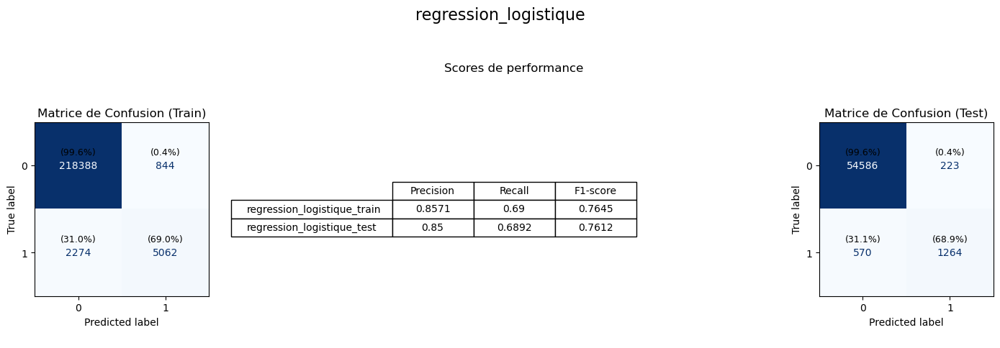

In [16]:
regression_logistique_scores = graph_perf(Y_train, Y_train_pred, Y_test, Y_test_pred, title="regression_logistique")



In [17]:
regression_logistique_scores 


,model,Precision,Recall,F1-score
0,regression_logistique_train,0.8571,0.6900,0.7645
1,regression_logistique_test,0.8500,0.6892,0.7612


### Decision tree

In [18]:
# 1. Initialiser le modèle
model_dec_tree = DecisionTreeClassifier()

# 2. Grille des hyperparamètres
params = {
    'max_depth': [4, 6, 8],
    'min_samples_leaf': [ 10, 12, 14],
    'min_samples_split': [1, 2, 3]
}

# 3. Recherche par validation croisée
gridsearch = GridSearchCV(model_dec_tree, param_grid=params, cv=3, n_jobs=-1, verbose=1)
gridsearch.fit(X_train, Y_train)

# 4. Afficher les meilleurs hyperparamètres
print("✅ GridSearch terminé.")
print("🔧 Meilleurs hyperparamètres :", gridsearch.best_params_)

# 5. Sauvegarder le meilleur modèle
best_dec_tree = gridsearch.best_estimator_
joblib.dump(best_dec_tree, "best_model_decision_tree_.joblib")
print("💾 Modèle DecisionTree sauvegardé dans : best_model_decision_tree.joblib")



Fitting 3 folds for each of 27 candidates, totalling 81 fits
✅ GridSearch terminé.
🔧 Meilleurs hyperparamètres : {'max_depth': 8, 'min_samples_leaf': 10, 'min_samples_split': 2}
💾 Modèle DecisionTree sauvegardé dans : best_model_decision_tree.joblib


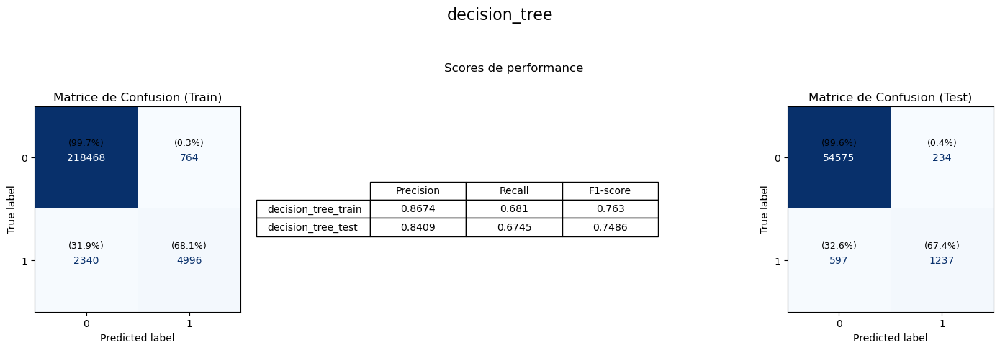

In [19]:
best_tree = gridsearch.best_estimator_

Y_train_pred = best_tree.predict(X_train)
Y_test_pred = best_tree.predict(X_test)


decision_tree_scores = graph_perf(Y_train, Y_train_pred, Y_test, Y_test_pred, title="decision_tree")



In [20]:
decision_tree_scores

,model,Precision,Recall,F1-score
0,decision_tree_train,0.8674,0.6810,0.7630
1,decision_tree_test,0.8409,0.6745,0.7486


### Random Forrest

In [21]:
model_ran_for = RandomForestClassifier(random_state=42, n_jobs=-1)

# Grille d’hyperparamètres à tester
params = {
    'n_estimators': [50, 100, 200],          # nombre d’arbres dans la forêt
    'max_depth': [ 6, 8, 10, None],        # profondeur max des arbres
    'min_samples_split': [8, 10, 12],         # min d’échantillons pour split
    'min_samples_leaf': [1, 2, 4],           # min d’échantillons dans une feuille
    'bootstrap': [True, False]               # échantillonnage avec ou sans remise
}

# Recherche avec validation croisée
gridsearch = GridSearchCV(estimator=model_ran_for, param_grid=params, cv=3, verbose=1, n_jobs=-1)
gridsearch.fit(X_train, Y_train)

# 4. Afficher les meilleurs hyperparamètres
print("✅ GridSearch terminé.")
print("🔧 Meilleurs hyperparamètres :", gridsearch.best_params_)

# 5. Sauvegarde du meilleur modèle
best_ran_for = gridsearch.best_estimator_
joblib.dump(best_ran_for, "best_model_random_forest.joblib")
print("💾 Modèle RandomForest sauvegardé dans : best_model_random_forest.joblib")


Fitting 3 folds for each of 216 candidates, totalling 648 fits
✅ GridSearch terminé.
🔧 Meilleurs hyperparamètres : {'bootstrap': True, 'max_depth': 10, 'min_samples_leaf': 2, 'min_samples_split': 8, 'n_estimators': 50}
💾 Modèle RandomForest sauvegardé dans : best_model_random_forest.joblib


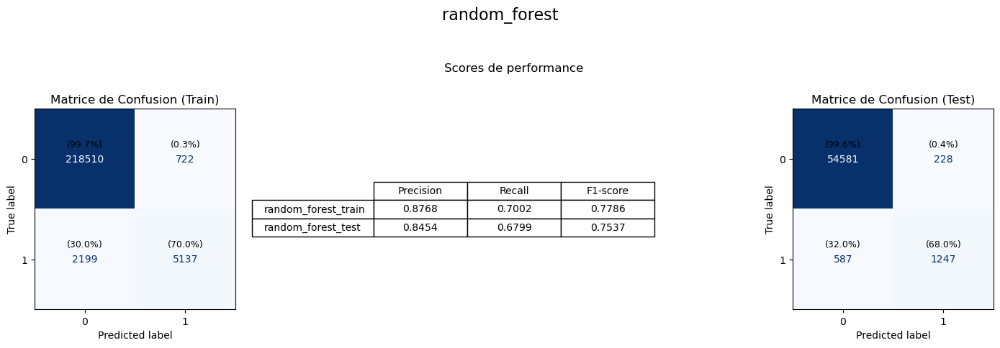

In [22]:
model_ran_for = gridsearch.best_estimator_

Y_train_pred = model_ran_for.predict(X_train)
Y_test_pred = model_ran_for.predict(X_test)

# Visualisation des performances
random_forest_scores = graph_perf(Y_train, Y_train_pred, Y_test, Y_test_pred, title="random_forest")


In [23]:
random_forest_scores

,model,Precision,Recall,F1-score
0,random_forest_train,0.8768,0.7002,0.7786
1,random_forest_test,0.8454,0.6799,0.7537


### Analyse 

In [24]:
df_all_scores = pd.concat([
    regression_logistique_scores,
    decision_tree_scores,
    random_forest_scores
], ignore_index=True)


In [25]:
df_all_scores

,model,Precision,Recall,F1-score
0,regression_logistique_train,0.8571,0.6900,0.7645
1,regression_logistique_test,0.8500,0.6892,0.7612
2,decision_tree_train,0.8674,0.6810,0.7630
3,decision_tree_test,0.8409,0.6745,0.7486
4,random_forest_train,0.8768,0.7002,0.7786
5,random_forest_test,0.8454,0.6799,0.7537


### Boosting methode

#### AdaBoost reg log

In [26]:
#modèle de base : régression logistique
reg_log_model = LogisticRegression(max_iter=1000)

# Modèle AdaBoost avec logistic regression comme estimateur
reglog_ada_boost = AdaBoostClassifier(estimator=reg_log_model)

# Grille des hyperparamètres à tester
params = {
    "estimator__C": [0.8, 1, 2, 3],          # C appartient à LogisticRegression
    "n_estimators": [10, 20, 40, 50]         # n_estimators = nombre d’itérations d’AdaBoost
}

# 4. GridSearchCV avec 10-fold
print("🔍 Lancement de la recherche de paramètres (GridSearch)...")
gridsearch = GridSearchCV(reglog_ada_boost, param_grid=params, cv=10, n_jobs=-1)
gridsearch.fit(X_train, Y_train)
print("✅ GridSearch terminé.")
print("🔧 Meilleurs hyperparamètres :", gridsearch.best_params_)

# 5. Sauvegarde du meilleur modèle
best_reglog_ada = gridsearch.best_estimator_
joblib.dump(best_reglog_ada, "best_model_reglog_ada_boost.joblib")
print("💾 Modèle AdaBoost (reglog) sauvegardé dans : best_model_reglog_ada_boost.joblib")



🔍 Lancement de la recherche de paramètres (GridSearch)...
✅ GridSearch terminé.
🔧 Meilleurs hyperparamètres : {'estimator__C': 2, 'n_estimators': 20}
💾 Modèle AdaBoost (reglog) sauvegardé dans : best_model_reglog_ada_boost.joblib


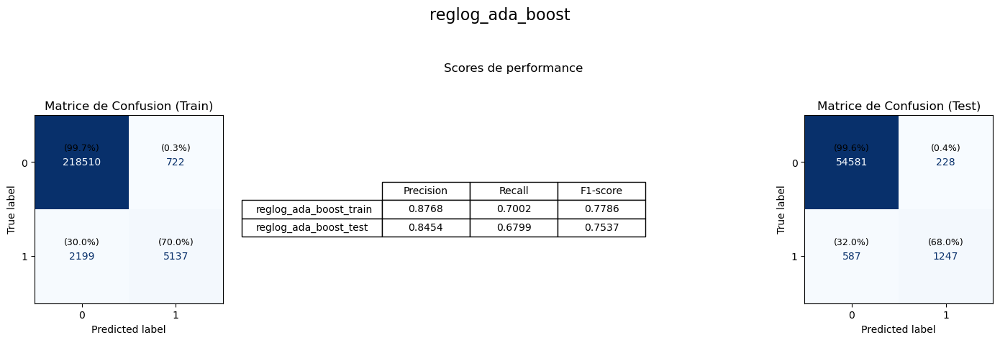

In [27]:
# Visualisation + récupération du DataFrame
reglog_ada_boost_scores = graph_perf(Y_train, Y_train_pred, Y_test, Y_test_pred, title="reglog_ada_boost")

In [28]:
reglog_ada_boost_scores

,model,Precision,Recall,F1-score
0,reglog_ada_boost_train,0.8768,0.7002,0.7786
1,reglog_ada_boost_test,0.8454,0.6799,0.7537


#### XG boost 

In [29]:
# Initialisation du modèle
xg_boost_model = XGBClassifier(
    random_state=42,
    use_label_encoder=False,  # nécessaire depuis XGBoost >= 1.3
    eval_metric="logloss"     # évite les warnings inutiles
)

# Grille des hyperparamètres
params = {
    'n_estimators': [100, 200, 300],
    'max_depth': [2, 3, 5],
    'learning_rate': [0.05, 0.1],
    'subsample': [0.6, 0.8, 1],
    'colsample_bytree': [0.5, 0.8, 1]
}

print("Recherche d'hyperparamètres XGBoost...")
gridsearch = GridSearchCV(
    estimator=xg_boost_model,
    param_grid=params,
    cv=5,
    n_jobs=-1,
    verbose=1
)
gridsearch.fit(X_train, Y_train)
print("✅ GridSearch terminé.")
print("🔧 Meilleurs hyperparamètres :", gridsearch.best_params_)

# 4. Meilleur modèle
best_xgb = gridsearch.best_estimator_

# 5. Sauvegarde
joblib.dump(best_xgb, "best_model_xg_boost.joblib")
print("💾 Modèle XGBoost sauvegardé dans : best_model_xg_boost.joblib")




Recherche d'hyperparamètres XGBoost...
Fitting 5 folds for each of 162 candidates, totalling 810 fits
✅ GridSearch terminé.
🔧 Meilleurs hyperparamètres : {'colsample_bytree': 0.8, 'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200, 'subsample': 0.8}
💾 Modèle XGBoost sauvegardé dans : best_model_xg_boost.joblib


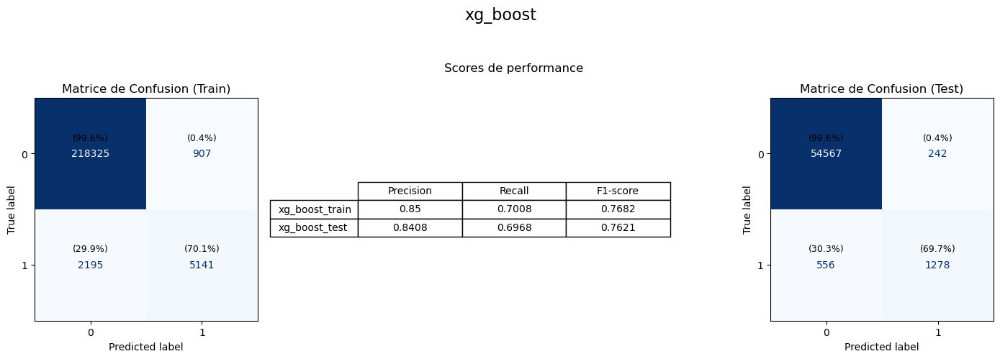

In [30]:
# Prédictions
Y_train_pred = best_xgb.predict(X_train)
Y_test_pred = best_xgb.predict(X_test)

# Affichage via ta fonction
xgboost_scores = graph_perf(Y_train, Y_train_pred, Y_test, Y_test_pred, title="xg_boost")

In [31]:
xgboost_scores

,model,Precision,Recall,F1-score
0,xg_boost_train,0.8500,0.7008,0.7682
1,xg_boost_test,0.8408,0.6968,0.7621


### analyse with boosting

In [32]:
df_all_scores_2 = pd.concat([
    regression_logistique_scores,
    decision_tree_scores,
    random_forest_scores,
    reglog_ada_boost_scores,
    xgboost_scores
], ignore_index=True)


In [33]:
df_all_scores_2

,model,Precision,Recall,F1-score
0,regression_logistique_train,0.8571,0.6900,0.7645
1,regression_logistique_test,0.8500,0.6892,0.7612
2,decision_tree_train,0.8674,0.6810,0.7630
3,decision_tree_test,0.8409,0.6745,0.7486
4,random_forest_train,0.8768,0.7002,0.7786
5,random_forest_test,0.8454,0.6799,0.7537
6,reglog_ada_boost_train,0.8768,0.7002,0.7786
7,reglog_ada_boost_test,0.8454,0.6799,0.7537
8,xg_boost_train,0.8500,0.7008,0.7682
9,xg_boost_test,0.8408,0.6968,0.7621


### Voting with top 3

✅ Soft Voting (vote pondéré par probabilité)
Chaque modèle retourne des probabilités (via .predict_proba()).

Le VotingClassifier fait la moyenne pondérée des probabilités de chaque classe.

Il prédit ensuite la classe avec la probabilité moyenne la plus élevée.

👉 C’est plus souple et souvent plus performant que le hard voting, car il prend en compte le niveau de confiance de chaque modèle.

##### top 3

In [34]:
# Filtrer uniquement les scores test
df_test_only = df_all_scores_2[df_all_scores_2["model"].str.endswith("_test")]

# Trier par F1-score décroissant
top_models = df_test_only.sort_values(by="F1-score", ascending=False).head(3)

# Extraire les noms des modèles de base
top_model_names = top_models["model"].str.replace("_test", "").tolist()
print("Top 3 modèles :", top_model_names)



Top 3 modèles : ['xg_boost', 'regression_logistique', 'random_forest']


✅ Modèle chargé : best_model_xg_boost.joblib
✅ Modèle chargé : best_model_regression_logistique.joblib
✅ Modèle chargé : best_model_random_forest.joblib
💾 VotingClassifier soft et hard sauvegardés.


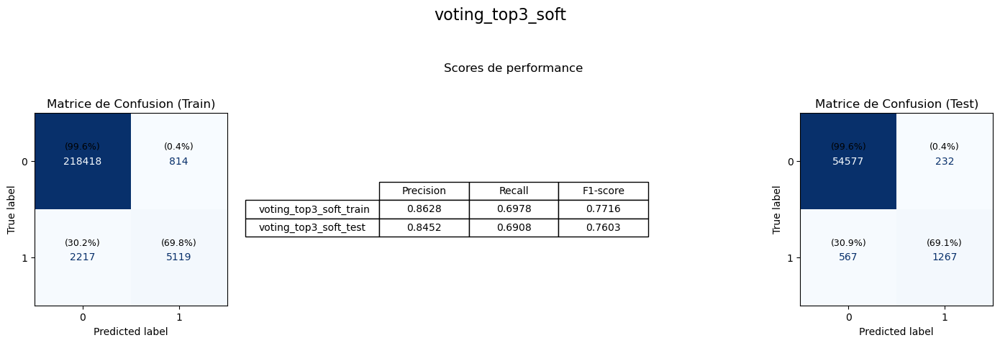

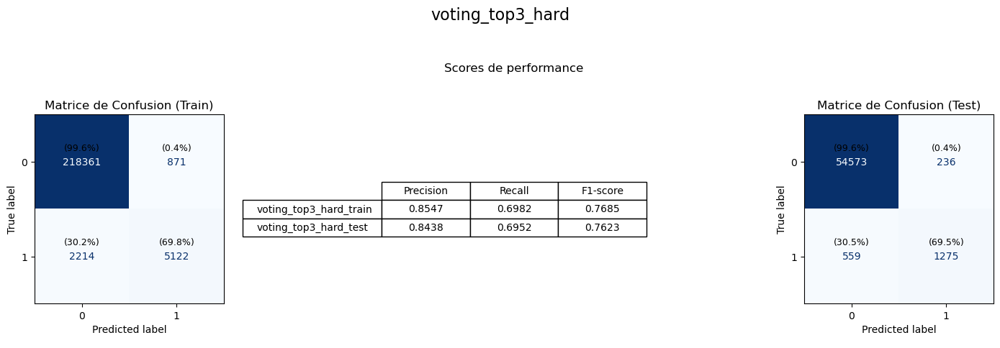

In [35]:
# Étape 1 : Charger les meilleurs modèles
top_model_names = ['xg_boost', 'regression_logistique', 'random_forest']
loaded_models = {}

for name in top_model_names:
    filepath = f"best_model_{name}.joblib"
    try:
        loaded_models[name] = joblib.load(filepath)
        print(f"✅ Modèle chargé : {filepath}")
    except FileNotFoundError:
        print(f"❌ Fichier introuvable : {filepath}")

# Étape 2 : Créer les VotingClassifiers
estimators = [(name, loaded_models[name]) for name in top_model_names]

voting_soft = VotingClassifier(estimators=estimators, voting='soft')
voting_soft.fit(X_train, Y_train)
joblib.dump(voting_soft, "best_model_voting_top3_soft.joblib")

voting_hard = VotingClassifier(estimators=estimators, voting='hard')
voting_hard.fit(X_train, Y_train)
joblib.dump(voting_hard, "best_model_voting_top3_hard.joblib")

print("💾 VotingClassifier soft et hard sauvegardés.")

# Étape 3 : Évaluer les performances avec graph_perf
# Soft Voting
Y_train_soft_pred = voting_soft.predict(X_train)
Y_test_soft_pred = voting_soft.predict(X_test)
df_voting_soft_scores = graph_perf(Y_train, Y_train_soft_pred, Y_test, Y_test_soft_pred, title="voting_top3_soft")

# Hard Voting
Y_train_hard_pred = voting_hard.predict(X_train)
Y_test_hard_pred = voting_hard.predict(X_test)
df_voting_hard_scores = graph_perf(Y_train, Y_train_hard_pred, Y_test, Y_test_hard_pred, title="voting_top3_hard")




In [36]:
df_voting_soft_scores

,model,Precision,Recall,F1-score
0,voting_top3_soft_train,0.8628,0.6978,0.7716
1,voting_top3_soft_test,0.8452,0.6908,0.7603


In [37]:
df_voting_hard_scores

,model,Precision,Recall,F1-score
0,voting_top3_hard_train,0.8547,0.6982,0.7685
1,voting_top3_hard_test,0.8438,0.6952,0.7623


In [40]:
df_all_scores_3 = pd.concat([
    df_all_scores_2,df_voting_soft_scores, df_voting_hard_scores
], ignore_index=True)

df_all_scores_3

,model,Precision,Recall,F1-score
0,regression_logistique_train,0.8571,0.6900,0.7645
1,regression_logistique_test,0.8500,0.6892,0.7612
2,decision_tree_train,0.8674,0.6810,0.7630
3,decision_tree_test,0.8409,0.6745,0.7486
4,random_forest_train,0.8768,0.7002,0.7786
5,random_forest_test,0.8454,0.6799,0.7537
6,reglog_ada_boost_train,0.8768,0.7002,0.7786
7,reglog_ada_boost_test,0.8454,0.6799,0.7537
8,xg_boost_train,0.8500,0.7008,0.7682
9,xg_boost_test,0.8408,0.6968,0.7621


### stacking with top precision et top recall models

In [41]:
# Filtrer les lignes "_test"
df_test_only = df_all_scores_3[df_all_scores_3["model"].str.endswith("_test")]

# Trouver le modèle avec la meilleure recall
best_recall_row = df_test_only.loc[df_test_only["Recall"].idxmax()]
best_recall_model_name = best_recall_row["model"].replace("_test", "")

# Trouver le modèle avec la meilleure précision
best_precision_row = df_test_only.loc[df_test_only["Precision"].idxmax()]
best_precision_model_name = best_precision_row["model"].replace("_test", "")

print("🔝 Meilleur modèle Recall :", best_recall_model_name)
print("🎯 Meilleur modèle Précision :", best_precision_model_name)

🔝 Meilleur modèle Recall : xg_boost
🎯 Meilleur modèle Précision : regression_logistique


In [42]:
model1 = load(f"best_model_{best_recall_model_name}.joblib")
model2 = load(f"best_model_{best_precision_model_name}.joblib")

# Créer les tuples (nom, modèle)
estimators = [
    ("recall_model", model1),
    ("precision_model", model2)
]

# Méta-modèle (empile les prédictions des 2)
stacking_model = StackingClassifier(
    estimators=estimators,
    final_estimator=LogisticRegression(),
    cv=5,
    n_jobs=-1
)




In [43]:
# Entraîner sur ton jeu d'entraînement
stacking_model.fit(X_train, Y_train)

joblib.dump(stacking_model, "best_model_stacking.joblib")

['best_model_stacking.joblib']

In [44]:
# Prédictions sur le jeu d'entraînement et de test
Y_train_pred = stacking_model.predict(X_train)
Y_test_pred = stacking_model.predict(X_test)


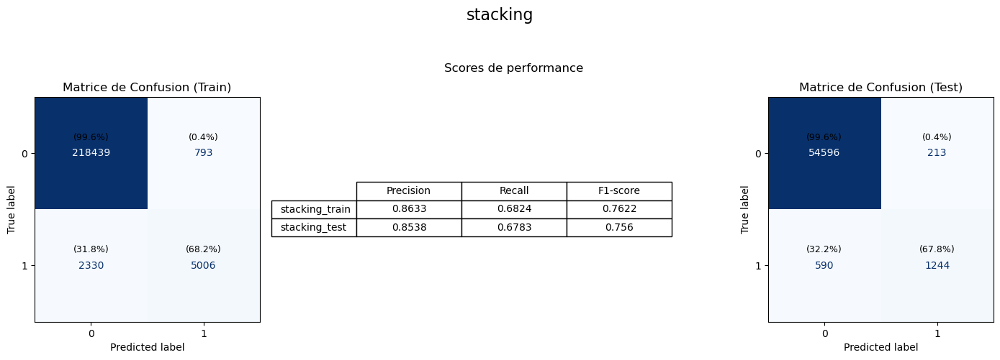

In [45]:
# Affichage des performances + sauvegarde automatique de l’instance si implémenté dans graph_perf
df_stacking_scores = graph_perf(Y_train, Y_train_pred, Y_test, Y_test_pred, title="stacking")


## resume

In [46]:
df_all_scores_4 = pd.concat([df_all_scores_3, df_stacking_scores], ignore_index=True)


In [47]:
df_all_scores_4

,model,Precision,Recall,F1-score
0,regression_logistique_train,0.8571,0.6900,0.7645
1,regression_logistique_test,0.8500,0.6892,0.7612
2,decision_tree_train,0.8674,0.6810,0.7630
3,decision_tree_test,0.8409,0.6745,0.7486
4,random_forest_train,0.8768,0.7002,0.7786
5,random_forest_test,0.8454,0.6799,0.7537
6,reglog_ada_boost_train,0.8768,0.7002,0.7786
7,reglog_ada_boost_test,0.8454,0.6799,0.7537
8,xg_boost_train,0.8500,0.7008,0.7682
9,xg_boost_test,0.8408,0.6968,0.7621


In [49]:
# Créer une copie de ton DataFrame global
df_plot = df_all_scores_4.copy()

# Extraire nom du modèle de base et type de dataset
df_plot["base_model"] = df_plot["model"].str.replace("_train", "", regex=False).str.replace("_test", "", regex=False)
df_plot["set"] = df_plot["model"].apply(lambda x: "Train" if "_train" in x else "Test")

# Trier les modèles selon F1-score décroissant sur le set Test
order = (
    df_plot[df_plot["set"] == "Test"]
    .sort_values(by="F1-score", ascending=False)["base_model"]
    .tolist()
)


fig = px.bar(
    df_plot,
    x="base_model",
    y="F1-score",
    color="set",
    barmode="group",
    category_orders={"base_model": order},
    color_discrete_map={"Train": "#8da0cb", "Test": "#fc8d62"},
    text="F1-score",
    title="🔍 Comparaison F1-score des modèles (Train vs Test)"
)

fig.update_traces(
    texttemplate='%{text:.3f}',
    textposition='inside',
    insidetextanchor='middle'
)

fig.update_layout(
    xaxis_title="Modèle",
    yaxis_title="F1-score",
    yaxis_range=[0, 1],
    xaxis_tickangle=-30,
    font=dict(size=14),
    title_font=dict(size=20),
    bargap=0.25,
    plot_bgcolor='rgba(245,245,245,1)',
    paper_bgcolor='white',
    legend=dict(
        title="Données",
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="center",
        x=0.5,
        font=dict(size=13)
    )
)

fig.show()



## Soumission du modele a un jeu de données 

### import du dataset à tester

In [ ]:
df_unlabeled = pd.read_csv("conversion_data_test.csv")
display(df_unlabeled.head())


### Preprocessing 

In [ ]:
# Charger le preprocessor complet (scaler + encodeur)
preprocessor = joblib.load("preprocessor.joblib")

# Vérifie que les colonnes d'entrée sont les bonnes
X_unlabeled = df_unlabeled[["age", "total_pages_visited", "country", "new_user", "source"]]

# Appliquer le même prétraitement que sur le train/test
X_unlabeled_processed = preprocessor.transform(X_unlabeled)


### import parametre du meilleur modele 

In [ ]:
# Exemple : si tu as sauvegardé le modèle XGBoost
modele_select = "best_model_xg_boost"  

model_loaded = joblib.load(f"{modele_select}.joblib")

print(f"✅ Modèle '{modele_select}' chargé.")


In [ ]:
# Prédiction sur le dataset non labellisé
y_pred_unlabeled = model_loaded.predict(X_unlabeled_processed)

# Ajouter les prédictions au DataFrame d'origine
df_unlabeled["converted"] = y_pred_unlabeled

# Afficher les résultats
display(df_unlabeled.head())

# (Optionnel) Sauvegarder les résultats dans un fichier CSV
df_unlabeled.to_csv("predictions_unlabeled.csv", index=False)
print("✅ Prédictions enregistrées dans 'predictions_unlabeled.csv'")
